# Project Report : How COVID-19 Affected Business in NYC Based on the Analysis of Taxi Activities



# Project Objective : 
**How COVID-19 Affected the world's largest financial centre NYC Based on the Analysis of Taxi Activities**
<br>
The project analyses how the COVID-19 pandemic affected the residents' activities and businesses in NYC, using all taxi data (green, yellow, fhv ). We will be analyzing the COVID-19 pandemic impact based on the following factors: number of taxi trips, passenger count, miles, fares, congestion fare and extra fees we will investigate further in 4 subtopics.
<br>

**Subtopic 1**: Impact of Passenger Counts and Trip Miles 
<br>

**Subtopic 2**: Impact of Tourism (using a proxy of airport and tourism spots taxi trips) 
<br>

**Subtopic 3**: Impact of Weekday/Weekend Congestion (assuming WFH/WFO activities had an impact on the number of taxi trips in 2020/2022) 
<br>

**Subtopic 4**: Impact of Tips (assumption here is it increased business activities giving rise to purchasing power, and tipping generosity)

## Plot 1 : How COVID-19 Affected Business from Passenger Counts

In [10]:

# Subtopic 1
# The purpose of this subproblem is to analyze the impact of the pandemic on the U.S. New York economy 
# by looking at the volume of cab trips in the New York before and after the pandemic from an overall perspective

In [11]:
# Import the function get_taxi_data() from utils.py
from utils import get_taxi_data
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import fastparquet

In [4]:

# The block is for plot 1
# Read data for the year from 2018 to 2022

year = np.arange(2018,2022,1)
                 
month = np.array(['01','02','03','04','05','06','07','08','09','10','11','12']) # from 2018 to 2021
month_2022 = np.array(['01','02','03','04','05','06','07','08']) # for 2022, we only have the data from 01 to 08 this year

# This is the data we want to support our analysis, the passenger counts and the trip_distance
cols_to_read = ['passenger_count',
               'trip_distance']

total_Y_headcount = []
total_Y_distance = []
total_G_headcount = []
total_G_distance = []
# Use the get_taxi_data function which is from utilys.py to download the data from the year 2018 to the year 2021
for i in year:
    count_Y = 0
    count_G = 0
    for j in month:
        df_Y = get_taxi_data(str(i),j,'yellow',columns = cols_to_read, save = True)
        count_Y = count_Y + df_Y.sum()
        df_G = get_taxi_data(str(i),j,'green',columns = cols_to_read, save = True)
        count_G = count_G + df_G.sum()
        
    total_Y_headcount.append(count_Y['passenger_count'])
    total_Y_distance.append(count_Y['trip_distance'])
    total_G_headcount.append(count_G['passenger_count'])
    total_G_distance.append(count_G['trip_distance'])
# The next codes are used the same idea above but read the data from year 2022 since its only have 8 months'datas
count_Y = 0
count_G = 0
for j in month_2022:
    df_Y = get_taxi_data('2022',j,'yellow',columns = cols_to_read)
    count_Y = count_Y + df_Y.sum()
        
    df_G = get_taxi_data('2022',j,'green',columns = cols_to_read)
    count_G = count_G + df_G.sum()

total_Y_headcount.append(count_Y['passenger_count'])
total_Y_distance.append(count_Y['trip_distance'])

total_G_headcount.append(count_G['passenger_count'])
total_G_distance.append(count_G['trip_distance'])

File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not in current folder; trying to download data...
File not i

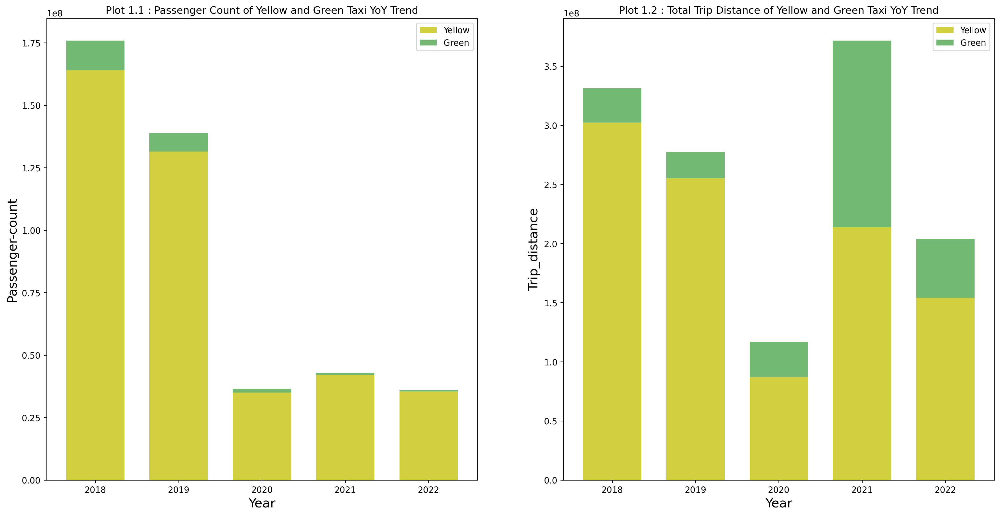

In [16]:
# The data in this case do not take the logarithm

def pass_trip():
    '''
        Returns the contents as mentioned below

        
        Returns
        -------
        2 subplots of yellow and green taxi data of passenger count and trip distance
        for 2018 - 2022 Aug. FHV doesn't have passenger count.
        
    
        Additional Info
        -------
        None
    '''
    year = [2018,2019,2020,2021,2022]

    plt.figure(figsize=(20, 10), dpi = 250)
    plt.subplot(121)

    N = len(year)
    x = np.arange(N) # xlabel
    width = 0.4
    x1 = x - width/2
    x2 = x + width/2



    # The first subplot about the total headcount of yellow and green in each year
    plt.bar(year,total_Y_headcount,color = 'y',width = 0.7, alpha = 0.75) 
    plt.bar(year,total_G_headcount, color = 'g', bottom = total_Y_headcount, width = 0.7, alpha = 0.55) 

    plt.legend(['Yellow', 'Green'], loc = 'upper right')
    plt.xlabel('Year', fontsize = 15)
    plt.ylabel('Passenger-count', fontsize = 15)
    plt.title('Plot 1.1 : Passenger Count of Yellow and Green Taxi YoY Trend')



    # The second subplot about the total trip distance of yellow and green in each year
    plt.subplot(122)
    plt.bar(year,total_Y_distance,color = 'y',width = 0.7, alpha = 0.75) 
    plt.bar(year,total_G_distance,color = 'g', bottom = total_Y_distance, width = 0.7, alpha = 0.55) 
    plt.legend(['Yellow', 'Green'], loc = 'upper right')
    plt.xlabel('Year', fontsize = 15)
    plt.ylabel('Trip_distance', fontsize = 15)
    plt.title('Plot 1.2 : Total Trip Distance of Yellow and Green Taxi YoY Trend')

    plt.show()

pass_trip()

### Plot 1 - Analysis

In the first graph, as time goes on, the number of people taking green taxi and yellow taxi both shows a **downward** trend. Because of the government's restrictions or prohibitions on personnel mobility, people need to work at home or hold online meetings, and students take classes online. In addition, with the development of the **logistics industry, online shopping, takeout and other online consumption patterns** become popular, and people can meet their consumption demands without going out, so the travel demand has **decreased** significantly. So from 2019 to 2022, the number of passengers taking taxi **decreases** dramatically.

In the second graph, the similar trend can be seen from 2018 to 2019 in both taxi, however, from 2019 to 2022, the trip distance **fluctuates**. For the yellow car, from 2019 to 2020, its distance decreases and from 2020 to 2022, it **increases** slightly and **decreases**. For the green car, the distance keeps the same from 2018 to 2020, and then **reaches a peak** in 2021 and finally **decreases** in 2022. For fear of being infected, people keep a social distance and avoid going to crowded places, such as stations and shopping malls. Therefore, people are reluctant to take public transport, which has brought a considerable **decline** to the relevant industries. People may prefer to travel by bike or on foot, because it is safer. Thus, from 2019 to 2020, the trip distance shows a **downward** trend. There are some differences between the yellow and green taxi, so it shows the different trend. Yellow taxis, also known as medal taxis, can pick up passengers anywhere in New York's five busiest districts. Another color of taxi is green taxi, which is only allowed to pick up passengers in Upper Manhattan, Bronx, Queens and Staten Island, excluding the two airports. Thus, whether it's trip distance or passenger, there are more people choosing yellow taxi.

## Plot 2 : How COVID-19 Affected Tourisms

In [24]:
# Subtopic 2
# The purpose of this subproblem is to analyze the impact of the pandemic on the U.S. New York economy 
# by looking at the volume of cab trips in New York before and after the pandemic from 
# tourism spots and airport visits based on the drop-off and pick-up location ID

In [25]:

# Construct year and month 
year = np.arange(2018, 2022, 1)
month = np.array(['01','02','03','04','05','06','07','08','09','10','11','12'])
month_2022 = np.array(['01','02','03','04','05','06','07','08'])


In [26]:
# Get FHV taxi data columns, the column are the pick up/drop off  location recorded using zone id
cols_to_read = ['PUlocationID',
                'DOlocationID']

# Download the data and get the specified columns, save the file locally
# Only until 2021 because 2022 has only 8 months data, will need to be in a separate loop
for i in year:
    for j in month:
        dfname = 'df_'+ str(i) + '_' + j
        #print(dfname)
        str_year = str(i)
        dfname = get_taxi_data(str_year, j, 'fhv', columns = cols_to_read, save = True)

# Get the data of 2022 from Jan - Aug
for j in month_2022:
    dfname = 'df_'+ str(i) + '_' + j
    dfname = get_taxi_data('2022', j, 'fhv', columns = cols_to_read, save = True)

In [27]:
def fhv_annual():
    '''
        Returns the contents as mentioned below


        Returns
        -------
        df_fhv_annual: pd dataframe of annual count of trips to airport and tourism 
        
    
        Additional Info
        -------
        None
    '''
    # Defining the year and months array
    year = np.arange(2018, 2022, 1)
    month = np.array(['01','02','03','04','05','06','07','08','09','10','11','12'])
    month_2022 = np.array(['01','02','03','04','05','06','07','08'])
    
    # Year list for     final dict
    year_list = ['2018','2019','2020','2021','2022']
    
    # Setting the loop for retrieving the data
    filelist = []
    dfnamelist = []
    for i in year:
        for j in month:
            filename = 'fhv_tripdata_' + str(i) + '-' + str(j) + '.parquet'
            filelist.append(filename)
    for j in month_2022:
        filename = 'fhv_tripdata_2022-' + str(j) + '.parquet'
        filelist.append(filename)

    for i in year:
        for j in month:
            dfname = 'df_' + str(i) + '_' + str(j)
            dfnamelist.append(dfname)
    for j in month_2022:
        dfname = 'df_2022_' + j
        dfnamelist.append(dfname)
        
  
    # Defining the empty lists for the final values
    airports_len = []
    tourism_len = []
    for i in range(len(dfnamelist)):
        dfnamelist[i] = pd.read_parquet(filelist[i])
        
        #To clean the NA rows
        dfnamelist[i].dropna(how = 'any')
        
        #1. To count how many trips in a month from and to airports
        filter_by_airports = dfnamelist[i].loc[(dfnamelist[i].DOlocationID == 1) | (dfnamelist[i]['DOlocationID'] == 132) |
                                       (dfnamelist[i]['DOlocationID'] == 138) | (dfnamelist[i]['PUlocationID'] == 1)|
                                        (dfnamelist[i]['PUlocationID'] == 132) | (dfnamelist[i]['PUlocationID'] == 138)]
        
        #2. To count how many trips in a month from and to tourism spots
        ''' 
        Central Park = 43
        Brooklyn Bridge,
        Empire State Building, Midtown South = 164
        Chinatown, Statue of Liberty, = 45
        Union Square = 234,
        Rockefeller Center = 164, 
        9/11 Memorial= 244,
        Penn Station/Grand Central =186, 
        Times Square =230
        '''
        tourism_spots_ID = [43,164,45,234,244,186,230]
        
        for j in tourism_spots_ID:
            filter_by_tourism = dfnamelist[i].loc[(dfnamelist[i].DOlocationID == j) | (dfnamelist[i].PUlocationID == j)]

        # Appending the length --> count of trips, to the empty lists
        trips_tourism = len(filter_by_tourism.index)
        tourism_len.append(trips_tourism)
        trips_airport = len(filter_by_airports.index)
        airports_len.append(trips_airport)
        
    # Building the dictionary of annual sum
    
    #1. Airport trips
    #Dictionary of lists 
    dict_airport = {'Month Filename': filelist, 'Count of Trips to Airport': airports_len} 
    df_airport = pd.DataFrame(dict_airport)
    
    year_2018_airport = sum(df_airport['Count of Trips to Airport'][0:12])
    year_2019_airport = sum(df_airport['Count of Trips to Airport'][12:24])
    year_2020_airport = sum(df_airport['Count of Trips to Airport'][24:36])
    year_2021_airport = sum(df_airport['Count of Trips to Airport'][36:48])
    year_2022_airport = sum(df_airport['Count of Trips to Airport'][48:56])
    year_airport = [year_2018_airport, year_2019_airport, year_2020_airport, year_2021_airport,year_2022_airport]
    
    #2. Tourism spot trips
    #Dictionary of lists 
    dict_tourism = {'Month Filename': filelist, 'Count of Trips to Tourism': tourism_len} 
    df_tourism = pd.DataFrame(dict_tourism)
    
    year_2018_tourism = sum(df_tourism['Count of Trips to Tourism'][0:12])
    year_2019_tourism = sum(df_tourism['Count of Trips to Tourism'][12:24])
    year_2020_tourism = sum(df_tourism['Count of Trips to Tourism'][24:36])
    year_2021_tourism = sum(df_tourism['Count of Trips to Tourism'][36:48])
    year_2022_tourism = sum(df_tourism['Count of Trips to Tourism'][48:56])
    year_tourism = [year_2018_tourism, year_2019_tourism, year_2020_tourism, year_2021_tourism,year_2022_tourism]
    
    #Annual combination
    annual_dict = {'Taxi_Type':'FHV','Year': year_list, 'Total Count of Trips to Airport': year_airport, 'Total Count of Trips to Tourism': year_tourism} 

    df_fhv_annual = pd.DataFrame(annual_dict)
    
    return df_fhv_annual

In [28]:
# Get green taxi data columns
cols_to_read = ['PULocationID',
                'DOLocationID']

# Download the data and get the specified columns, save the file locally
# Only until 2021 because 2022 has only 8 months data, will need to be in a separate loop
for i in year:
    for j in month:
        dfname = 'df_'+ str(i) + '_' + j
        #print(dfname)
        str_year = str(i)
        dfname = get_taxi_data(str_year, j, 'green', columns = cols_to_read, save = True)
        

In [29]:
# Get green taxi data in 2022
for j in month_2022:
    dfname = 'df_'+ str(i) + '_' + j
    dfname = get_taxi_data('2022', j, 'green', columns = cols_to_read, save = True)

In [30]:
def green_annual():
    '''
        Returns the contents as mentioned below

        Returns
        -------
        df_annual_green: pd dataframe of annual count of trips to airport and tourism 
        
    
        Additional Info
        -------
        None
    '''
    # Defining the year and months array
    year = np.arange(2018, 2022, 1)
    month = np.array(['01','02','03','04','05','06','07','08','09','10','11','12'])
    month_2022 = np.array(['01','02','03','04','05','06','07','08'])
    
    # Year list for final dict
    year_list = ['2018','2019','2020','2021','2022']
    
    # Setting the loop for retrieving the data
    filelist = []
    dfnamelist = []
    for i in year:
        for j in month:
            filename = 'green_tripdata_' + str(i) + '-' + str(j) + '.parquet'
            filelist.append(filename)
    for j in month_2022:
        filename = 'green_tripdata_2022-' + str(j) + '.parquet'
        filelist.append(filename)

    for i in year:
        for j in month:
            dfname = 'df_' + str(i) + '_' + str(j)
            dfnamelist.append(dfname)
    for j in month_2022:
        dfname = 'df_2022_' + j
        dfnamelist.append(dfname)
        
  
    # Defining the empty lists for the final values
    airports_len = []
    tourism_len = []
    for i in range(len(dfnamelist)):
        dfnamelist[i] = pd.read_parquet(filelist[i])
        
        #To clean the NA rows
        dfnamelist[i].dropna(how = 'any')
        
        #1. To count how many trips in a month from and to airports
        filter_by_airports = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == 1) | (dfnamelist[i]['DOLocationID'] == 132) |
                                       (dfnamelist[i]['DOLocationID'] == 138) | (dfnamelist[i]['PULocationID'] == 1)|
                                        (dfnamelist[i]['PULocationID'] == 132) | (dfnamelist[i]['PULocationID'] == 138)]
        
        #2. To count how many trips in a month from and to tourism spots
        ''' 
        Central Park = 43
        Brooklyn Bridge,
        Empire State Building, Midtown South = 164
        Chinatown, Statue of Liberty, = 45
        Union Square = 234,
        Rockefeller Center = 164, 
        9/11 Memorial= 244,
        Penn Station/Grand Central =186, 
        Times Square =230
        '''
        tourism_spots_ID = [43,164,45,234,244,186,230]
        
        for j in tourism_spots_ID:
            filter_by_tourism = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == j) | (dfnamelist[i].PULocationID == j)]

        # Appending the length --> count of trips, to the empty lists
        trips_tourism = len(filter_by_tourism.index)
        tourism_len.append(trips_tourism)
        trips_airport = len(filter_by_airports.index)
        airports_len.append(trips_airport)
        
    # Building the dictionary of annual sum
    
    #1. Airport trips
    #Dictionary of lists 
    dict_airport = {'Month Filename': filelist, 'Count of Trips to Airport': airports_len} 
    df_airport = pd.DataFrame(dict_airport)
    
    year_2018_airport = sum(df_airport['Count of Trips to Airport'][0:12])
    year_2019_airport = sum(df_airport['Count of Trips to Airport'][12:24])
    year_2020_airport = sum(df_airport['Count of Trips to Airport'][24:36])
    year_2021_airport = sum(df_airport['Count of Trips to Airport'][36:48])
    year_2022_airport = sum(df_airport['Count of Trips to Airport'][48:56])
    year_airport = [year_2018_airport, year_2019_airport, year_2020_airport, year_2021_airport,year_2022_airport]
    
    #2. Tourism spot trips
    #Dictionary of lists 
    dict_tourism = {'Month Filename': filelist, 'Count of Trips to Tourism': tourism_len} 
    df_tourism = pd.DataFrame(dict_tourism)
    
    year_2018_tourism = sum(df_tourism['Count of Trips to Tourism'][0:12])
    year_2019_tourism = sum(df_tourism['Count of Trips to Tourism'][12:24])
    year_2020_tourism = sum(df_tourism['Count of Trips to Tourism'][24:36])
    year_2021_tourism = sum(df_tourism['Count of Trips to Tourism'][36:48])
    year_2022_tourism = sum(df_tourism['Count of Trips to Tourism'][48:56])
    year_tourism = [year_2018_tourism, year_2019_tourism, year_2020_tourism, year_2021_tourism,year_2022_tourism]
    
    #Annual combination
    annual_dict_green = {'Taxi_Type' : 'Green','Year': year_list, 'Total Count of Trips to Airport': year_airport, 'Total Count of Trips to Tourism': year_tourism} 

    df_annual_green = pd.DataFrame(annual_dict_green)
    
    return df_annual_green

# green_annual()

In [31]:
# Defining the year and months array
year = np.arange(2018, 2022, 1)
month = np.array(['01','02','03','04','05','06','07','08','09','10','11','12'])
month_2022 = np.array(['01','02','03','04','05','06','07','08'])

# Get yellow taxi data 2018 - 2021
cols_to_read = ['PULocationID',
                'DOLocationID']

# Download the data and get the specified columns, save the file locally
# Only until 2021 because 2022 has only 8 months data, will need to be in a separate loop
for i in year:
    for j in month:
        dfname = 'df_'+ str(i) + '_' + j
       
        str_year = str(i)
        dfname = get_taxi_data(str_year, j, 'yellow', columns = cols_to_read, save = True)

# Get yellow taxi data in 2022
for j in month_2022:
    dfname = 'df_'+ str(i) + '_' + j
    dfname = get_taxi_data('2022', j, 'yellow', columns = cols_to_read, save = True)

File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-download

In [32]:
def yellow_annual():
    '''
        Returns the contents as mentioned below

        Returns
        -------
        df_annual_yellow: pd dataframe of annual count of trips to airport and tourism 
        
    
        Additional Info
        -------
        None
    '''
    # Defining the year and months array
    year = np.arange(2018, 2022, 1)
    month = np.array(['01','02','03','04','05','06','07','08','09','10','11','12'])
    month_2022 = np.array(['01','02','03','04','05','06','07','08'])
    
    # Year list for final dict
    year_list = ['2018','2019','2020','2021','2022']
    
    # Setting the loop for retrieving the data
    filelist = []
    dfnamelist = []
    for i in year:
        for j in month:
            filename = 'yellow_tripdata_' + str(i) + '-' + str(j) + '.parquet'
            filelist.append(filename)
    for j in month_2022:
        filename = 'yellow_tripdata_2022-' + str(j) + '.parquet'
        filelist.append(filename)

    for i in year:
        for j in month:
            dfname = 'df_' + str(i) + '_' + str(j)
            dfnamelist.append(dfname)
    for j in month_2022:
        dfname = 'df_2022_' + j
        dfnamelist.append(dfname)
        
  
    # Defining the empty lists for the final values
    airports_len = []
    tourism_len = []
    for i in range(len(dfnamelist)):
        dfnamelist[i] = pd.read_parquet(filelist[i])
        
        #To clean the NA rows
        dfnamelist[i].dropna(how = 'any')
        
        
        #1. To count how many trips in a month from and to airports
       
        filter_by_airports = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == 1) | (dfnamelist[i]['DOLocationID'] == 132) |
                                       (dfnamelist[i]['DOLocationID'] == 138) | (dfnamelist[i]['PULocationID'] == 1)|
                                        (dfnamelist[i]['PULocationID'] == 132) | (dfnamelist[i]['PULocationID'] == 138)]
        
        #2. To count how many trips in a month from and to tourism spots
        ''' 
        Central Park = 43
        Brooklyn Bridge,
        Empire State Building, Midtown South = 164
        Chinatown, Statue of Liberty, = 45
        Union Square = 234,
        Rockefeller Center = 164, 
        9/11 Memorial= 244,
        Penn Station/Grand Central =186, 
        Times Square =230
        '''
        tourism_spots_ID = [43,164,45,234,244,186,230]
        
        for j in tourism_spots_ID:
            filter_by_tourism = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == j) | (dfnamelist[i].PULocationID == j)]

        # Appending the length --> count of trips, to the empty lists
        no_filter = len(dfnamelist[i])
        trips_tourism = len(filter_by_tourism.index)
        tourism_len.append(trips_tourism)
        trips_airport = len(filter_by_airports.index)
        airports_len.append(trips_airport)
        
    # Building the dictionary of annual sum
    
    #1. Airport trips
    #Dictionary of lists 
    dict_airport = {'Month Filename': filelist, 'Count of Trips to Airport': airports_len} 
    df_airport = pd.DataFrame(dict_airport)
    
    year_2018_airport = sum(df_airport['Count of Trips to Airport'][0:12])
    year_2019_airport = sum(df_airport['Count of Trips to Airport'][12:24])
    year_2020_airport = sum(df_airport['Count of Trips to Airport'][24:36])
    year_2021_airport = sum(df_airport['Count of Trips to Airport'][36:48])
    year_2022_airport = sum(df_airport['Count of Trips to Airport'][48:56])
    year_airport = [year_2018_airport, year_2019_airport, year_2020_airport, year_2021_airport,year_2022_airport]
    
    #2. Tourism spot trips
    #Dictionary of lists 
    dict_tourism = {'Month Filename': filelist, 'Count of Trips to Tourism': tourism_len} 
    df_tourism = pd.DataFrame(dict_tourism)
    
    year_2018_tourism = sum(df_tourism['Count of Trips to Tourism'][0:12])
    year_2019_tourism = sum(df_tourism['Count of Trips to Tourism'][12:24])
    year_2020_tourism = sum(df_tourism['Count of Trips to Tourism'][24:36])
    year_2021_tourism = sum(df_tourism['Count of Trips to Tourism'][36:48])
    year_2022_tourism = sum(df_tourism['Count of Trips to Tourism'][48:56])
    year_tourism = [year_2018_tourism, year_2019_tourism, year_2020_tourism, year_2021_tourism,year_2022_tourism]
    
    #Annual combination
    annual_dict_yellow = {'Taxi_Type' :'Yellow','Year': year_list, 'Total Count of Trips to Airport': year_airport, 'Total Count of Trips to Tourism': year_tourism} 

    df_annual_yellow = pd.DataFrame(annual_dict_yellow)
    
    return df_annual_yellow

In [33]:
# Concatenate the df from 3 types of cabs

df_yellow = yellow_annual()
df_green= green_annual()
df_fhv = fhv_annual()
df_count_trips = pd.concat([df_yellow, df_green,df_fhv], axis=0)
df_count_trips['Total Count of Trips to Airport'] = np.log(df_count_trips['Total Count of Trips to Airport'])
df_count_trips['Total Count of Trips to Tourism'] =np.log(df_count_trips ['Total Count of Trips to Tourism'])

In [34]:
# Showing the plot of fare amount and year during the holiday season - month: June - Sep
# Not using Dec - Jan because 2022 data don't have it yet
# Construct year and month 
year = np.arange(2019, 2023, 1)
month = np.array(['06','07','08','09'])
# Get green, yellow, HV - FHV taxi data columns, the column are the pick up/drop off  location recorded using zone id
cols_to_read = ['PULocationID',
                'DOLocationID',
               'base_passenger_fare',
               'tips']

cols_to_read_green_yellow = ['PULocationID',
                'DOLocationID',
                 'passenger_count',
                'trip_distance',
               'fare_amount',
                'tip_amount']
# Download the data and get the specified columns, save the file locally

for i in year:
    for j in month:
        dfname = 'df_'+ str(i) + '_' + j
        #print(dfname)
        str_year = str(i)
        dfname_hv = get_taxi_data(str_year, j, 'fhvhv', columns = cols_to_read, save = True)
        dfname_green = get_taxi_data(str_year, j, 'green', columns = cols_to_read_green_yellow, save = True)
        dfname_yellow = get_taxi_data(str_year, j, 'yellow', columns = cols_to_read_green_yellow, save = True)

File not in current folder; trying to download data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File not in current folder; trying to download data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File not in current folder; trying to download data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File not in current folder; trying to download data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File not in current folder; trying to downlo

In [36]:
def summer_holiday_fare(cabtype):
    '''
        Reads the 'cabtype' variable called by the user and returns the contents as mentioned below

        Parameters
        ----------
        cabtype    :   'green' or 'yellow'

        Returns
        -------
        df_annual: pd dataframe of annual sum of fare to airport and tourism 
        
    
        Additional Info
        -------
        None
    '''
    # Defining the year and months array
    year = np.arange(2019, 2023, 1)
    month = np.array(['06','07','08','09'])
    
    # Year list for final dict
    year_list = ['2019','2020','2021','2022']
    
    # Setting the loop for retrieving the data
    filelist = []
    dfnamelist = []
    
    # Retrieving the data
    for i in year:
        for j in month:
            filename = cabtype + '_tripdata_' + str(i) + '-' + str(j) + '.parquet'
            filelist.append(filename)
    
    for i in year:
        for j in month:
            dfname = 'df_' + str(i) + '_' + str(j)
            dfnamelist.append(dfname)
    
        
    # Defining the empty lists for the final values
    airports_fare = []
    tourism_fare = []
    for i in range(len(dfnamelist)):
        dfnamelist[i] = pd.read_parquet(filelist[i])
        
        #To clean the NA rows
        dfnamelist[i].dropna(how = 'any')
        
        #1. To sum fare in a month from and to airports
        filter_by_airports = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == 1) | (dfnamelist[i]['DOLocationID'] == 132) |
                                       (dfnamelist[i]['DOLocationID'] == 138) | (dfnamelist[i]['PULocationID'] == 1)|
                                        (dfnamelist[i]['PULocationID'] == 132) | (dfnamelist[i]['PULocationID'] == 138)]
        
        #2. To sum fare in a month from and to tourism spots
        ''' 
        Central Park = 43
        Empire State Building, Midtown South = 164
        Chinatown, Statue of Liberty, = 45
        Union Square = 234,
        Rockefeller Center = 164, 
        9/11 Memorial= 244,
        Penn Station/Grand Central =186, 
        Times Square =230
        '''
        tourism_spots_ID = [43,164,45,234,244,186,230]
        
        for j in tourism_spots_ID:
            filter_by_tourism = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == j) | (dfnamelist[i].PULocationID == j)]

        # Appending the length --> sum of fare, to the empty lists
       
        trips_tourism = sum(filter_by_tourism['fare_amount'])
        tourism_fare.append(trips_tourism)
        trips_airport = sum(filter_by_airports['fare_amount'])
        airports_fare.append(trips_airport)
        
        
        
    # Building the dictionary of annual sum
    
    #1. Airport trips
    #Dictionary of lists 
    dict_airport = {'Month Filename': filelist, 'Sum of Fare to Airport': airports_fare} 
    df_airport = pd.DataFrame(dict_airport)
    
    year_2019_airport = sum(df_airport['Sum of Fare to Airport'][0:4])
    year_2020_airport = sum(df_airport['Sum of Fare to Airport'][4:8])
    year_2021_airport = sum(df_airport['Sum of Fare to Airport'][8:12])
    year_2022_airport = sum(df_airport['Sum of Fare to Airport'][12:16])
    year_airport = [year_2019_airport, year_2020_airport, year_2021_airport,year_2022_airport]
    
    #2. Tourism spot trips
    #Dictionary of lists 
    dict_tourism = {'Month Filename': filelist, 'Sum of Fare to Tourism': tourism_fare} 
    df_tourism = pd.DataFrame(dict_tourism)
    
    year_2019_tourism = sum(df_tourism['Sum of Fare to Tourism'][0:4])
    year_2020_tourism = sum(df_tourism['Sum of Fare to Tourism'][4:8])
    year_2021_tourism = sum(df_tourism['Sum of Fare to Tourism'][8:12])
    year_2022_tourism = sum(df_tourism['Sum of Fare to Tourism'][12:16])
    year_tourism = [year_2019_tourism, year_2020_tourism, year_2021_tourism,year_2022_tourism]
    
    #Annual combination
    annual_dict = {'Taxi_Type' : cabtype,'Year': year_list, 'Total Sum of Fare to Airport': year_airport, 'Total Sum of Fare to Tourism': year_tourism} 

    df_annual = pd.DataFrame(annual_dict)
    
    return df_annual



In [37]:
def fhvhv_holiday_fare():
    
    '''
        Reads the 'cabtype' variable called by the user and returns the contents as mentioned below

        Parameters
        ----------
        cabtype    :   'green' or 'yellow'

        Returns
        -------
        df_annual_fhvhv: pd dataframe of annual sum of fare to airport and tourism 
        
    
        Additional Info
        -------
        None
    '''
    # Defining the year and months array
    year = np.arange(2019, 2023, 1)
    month = np.array(['06','07','08','09'])
    
    # Year list for final dict
    year_list = ['2019','2020','2021','2022']
    
    # Setting the loop for retrieving the data
    filelist = []
    dfnamelist = []
    # Green cab
    for i in year:
        for j in month:
            filename = 'fhvhv_tripdata_' + str(i) + '-' + str(j) + '.parquet'
            filelist.append(filename)
    
    for i in year:
        for j in month:
            dfname = 'df_' + str(i) + '_' + str(j)
            dfnamelist.append(dfname)
    
        
    # Defining the empty lists for the final values
    airports_fare = []
    tourism_fare = []
    for i in range(len(dfnamelist)):
        dfnamelist[i] = pd.read_parquet(filelist[i])
        
        #To clean the NA rows
        dfnamelist[i].dropna(how = 'any')
        
        #1. To count how many trips in a month from and to airports
        filter_by_airports = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == 1) | (dfnamelist[i]['DOLocationID'] == 132) |
                                       (dfnamelist[i]['DOLocationID'] == 138) | (dfnamelist[i]['PULocationID'] == 1)|
                                        (dfnamelist[i]['PULocationID'] == 132) | (dfnamelist[i]['PULocationID'] == 138)]
        
        #2. To sum in a month from and to tourism spots
        ''' 
        Central Park = 43
        Brooklyn Bridge,
        Empire State Building, Midtown South = 164
        Chinatown, Statue of Liberty, = 45
        Union Square = 234,
        Rockefeller Center = 164, 
        9/11 Memorial= 244,
        Penn Station/Grand Central =186, 
        Times Square =230
        '''
        tourism_spots_ID = [43,164,45,234,244,186,230]
        
        for j in tourism_spots_ID:
            filter_by_tourism = dfnamelist[i].loc[(dfnamelist[i].DOLocationID == j) | (dfnamelist[i].PULocationID == j)]

        # Appending the length --> sum of fare, to the empty lists
     
        trips_tourism = sum(filter_by_tourism['base_passenger_fare'])
        tourism_fare.append(trips_tourism)
        trips_airport = sum(filter_by_airports['base_passenger_fare'])
        airports_fare.append(trips_airport)
        
        
        
    # Building the dictionary of annual sum
    
    #1. Airport trips
    #Dictionary of lists 
    dict_airport = {'Month Filename': filelist, 'Sum of Fare to Airport': airports_fare} 
    df_airport = pd.DataFrame(dict_airport)
    
    year_2019_airport = sum(df_airport['Sum of Fare to Airport'][0:4])
    year_2020_airport = sum(df_airport['Sum of Fare to Airport'][4:8])
    year_2021_airport = sum(df_airport['Sum of Fare to Airport'][8:12])
    year_2022_airport = sum(df_airport['Sum of Fare to Airport'][12:16])
    year_airport = [year_2019_airport, year_2020_airport, year_2021_airport,year_2022_airport]
    
    #2. Tourism spot trips
    #Dictionary of lists 
    dict_tourism = {'Month Filename': filelist, 'Sum of Fare to Tourism': tourism_fare} 
    df_tourism = pd.DataFrame(dict_tourism)
    
    year_2019_tourism = sum(df_tourism['Sum of Fare to Tourism'][0:4])
    year_2020_tourism = sum(df_tourism['Sum of Fare to Tourism'][4:8])
    year_2021_tourism = sum(df_tourism['Sum of Fare to Tourism'][8:12])
    year_2022_tourism = sum(df_tourism['Sum of Fare to Tourism'][12:16])
    year_tourism = [year_2019_tourism, year_2020_tourism, year_2021_tourism,year_2022_tourism]
    
    #Annual combination
    annual_dict_fhvhv = {'Taxi_Type' : 'FHVHV','Year': year_list, 'Total Sum of Fare to Airport': year_airport, 'Total Sum of Fare to Tourism': year_tourism} 

    df_annual_fhvhv = pd.DataFrame(annual_dict_fhvhv)
    
    return df_annual_fhvhv


In [38]:
# Concatenate the df from 3 types of cabs

df_green = summer_holiday_fare('green')
df_yellow = summer_holiday_fare('yellow')
df_fhvhv = fhvhv_holiday_fare()
df_summer_holiday = pd.concat([df_green,df_yellow, df_fhvhv], axis=0)
df_new_summer = df_summer_holiday.copy().reset_index()
df_new_summer

,index,Taxi_Type,Year,Total Sum of Fare to Airport,Total Sum of Fare to Tourism
0,0,green,2019,9.533381e+05,1.643631e+05
1,1,green,2020,5.998058e+04,1.288271e+04
2,2,green,2021,2.211242e+05,2.784263e+04
3,3,green,2022,3.895068e+05,3.989776e+04
4,0,yellow,2019,8.833361e+07,2.263474e+07
5,1,yellow,2020,4.895477e+06,9.330305e+05
6,2,yellow,2021,3.585520e+07,6.382864e+06
7,3,yellow,2022,5.935149e+07,1.196703e+07
8,0,FHVHV,2019,2.810572e+08,4.272039e+07
9,1,FHVHV,2020,3.852528e+07,7.041584e+06


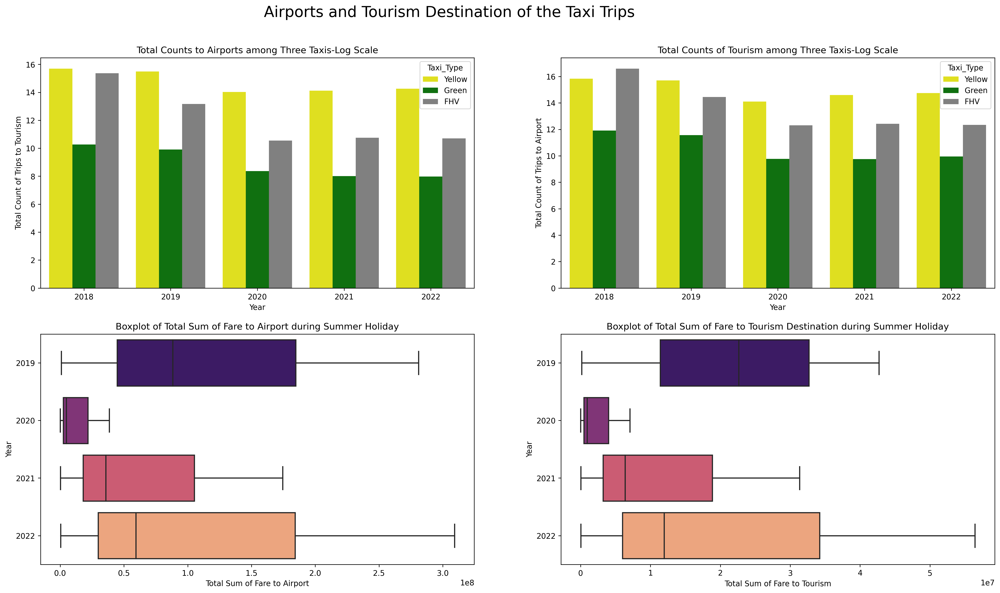

In [42]:
#Lines 25-26: Towardsdatascience.com
#URL: https://towardsdatascience.com/how-to-use-your-own-color-palettes-with-seaborn-a45bf5175146
#Accessed on 5 Dec 11.00

def plot_subtask_2(input_df_1, input_df_2):
    '''
        Reads the 'input_df' variables called by the user and returns the contents as mentioned below

        Parameters
        ----------
        input_df_1 : df of count of trips to tourism and airport
        input_df_2 : df of sum of fare to tourism and airport

        Returns
        -------
        4 subplots
        
    
        Additional Info
        -------
        None
    '''
    # Set seaborn palette
    
    colors = ['yellow', 'green', 'gray']
    customPalette = sns.set_palette(sns.color_palette(colors))
    
    # Define plotting region (2 rows, 2 columns)
    fig = plt.figure(figsize = (20, 12), dpi = 250)
    fig.suptitle("Airports and Tourism Destination of the Taxi Trips", fontsize = 20)
    
    # Needed to add spacing between 1st and 2nd col
    # Add a margin between the main title and sub-plots
    fig.subplots_adjust(wspace = 0.2, hspace = 0.2, top = 0.9, right = 1)
    
    # Plot Airport Count of Trips
    plt.subplot(2,2,1)
    sns.barplot(data = input_df_1, x = 'Year', y = 'Total Count of Trips to Tourism', hue = 'Taxi_Type',
               palette = customPalette).set(
        title = 'Total Counts to Airports among Three Taxis-Log Scale')
    
    # Plot Tourism Count of Trips
    plt.subplot(2,2,2)
    sns.barplot(data = input_df_1, x = 'Year', y = 'Total Count of Trips to Airport', hue = 'Taxi_Type',
               palette = customPalette).set(
        title = 'Total Counts of Tourism among Three Taxis-Log Scale')
    
    # Plot Airport Sum of Fare in Peak Season, comparing years
    plt.subplot(2,2,3)
    sns.boxplot(y = input_df_2['Year'], x = input_df_2['Total Sum of Fare to Airport'],
                                                      palette = 'magma').set(
        title = 'Boxplot of Total Sum of Fare to Airport during Summer Holiday')

    
    # Plot Airport Sum of Fare in Peak Season, comparing years
    plt.subplot(2,2,4)
    sns.boxplot(y = input_df_2['Year'], x = input_df_2['Total Sum of Fare to Tourism'],
               palette = 'magma').set(
        title='Boxplot of Total Sum of Fare to Tourism Destination during Summer Holiday')
    plt.show()
    
    
plot_subtask_2(df_count_trips, df_new_summer)

### Plot 2 - Analysis

The main idea of plot 2 is to show how the pandemic impacts three types of vehicles based on four subplots.

The first and the second subplot supports the aim by showing the total tourism for each type of vehicle each year. Since the raw data does not specify whether the passenger is a tourist, it is necessary to look for a particular time range, for example, summer holidays and pick-up/drop-off zone ID. In order to pressure the high likelihood that the passager is a tourist, the picked months are from June to September, which is the time range just covering the summer holidays. The chosen zone IDs are the top nine famous sightseeing sites and airports located. The idea we count the trips is that each time the driver drops off and picks up at these chosen zones is considered a trip.

After the total counts corresponding to each type of vehicle were calculated, there was a significant gap between FHV and taxis which would make the subplots less visualizing to readers. The use of the log function applied to the total trip counts then fixed this problem.

From the first two plots, the overall trend is that tourists decreased. It is also clear to see that yellow taxis are always the most popular choice for passengers; oppositely, green taxis are the least popular. 

The main reason for this tourist decrease is due to the pandemic. Meanwhile, the cost could also be the second important factor that implies the result. 

As a result, the last two subplots stand for the fare amount each year. The last two subplots are box plots showing the range of the fare amount each year. From the last two subplots, the overall trend of fare amounts remains the same over time. Nevertheless, the fare amount even decreased in the year 2020 when the government ordered the closing of non-essential businesses. Thus, these two subplots regarding the fare amount should be enough to explain that the decrease in tourists is mainly because of COVID-19.

## Plot 3 : How COVID-19 Affects the Congestions

In [60]:
# Subtopic 3
# The purpose of this subproblem is to know the 
# Dependency libraries/packages: Geopandas, folium

In [63]:
# Adding this pip install comment to run if you don't have geopandas installed yet 
# pip install geopandas

In [64]:
# Adding this pip install comment to run if you don't have geopandas installed yet 
# pip install folium matplotlib mapclassify

In [48]:
# 3. Plots using geopandas and matplotlib 
# Congestion Analysis in weekdays and weekends (before, after COVID - April 2020 and April 2022) using "congestion_surcharge" and "extra" variables
# using geopandas to generate New York City Maps
import geopandas as gpd


# reading shape files of taxi zones
taxi_zones_df = gpd.read_file("taxi_zones/taxi_zones.shp")

In [47]:
# Get green, yellow, and FHV taxi data columns
cols_yellow = ['tpep_pickup_datetime',
                'congestion_surcharge',
               'PULocationID']

cols_green = ['lpep_pickup_datetime',
              'extra',
               'PULocationID']

cols_fhvhv = ['pickup_datetime',
              'congestion_surcharge',
               'PULocationID']

# Download 2020 April data for all cabs
df_apr_2020_yellow = get_taxi_data('2020', '04', 'yellow', columns = cols_yellow, save = True)
df_apr_2020_green = get_taxi_data('2020', '04', 'green', columns = cols_green, save = True)
df_apr_2020_fhv = get_taxi_data('2020', '04', 'fhvhv', columns = cols_fhvhv, save = True)


# Download 2022 April data for all cabs
df_apr_2022_yellow = get_taxi_data('2022', '04', 'yellow', columns = cols_yellow, save = True)
df_apr_2022_green = get_taxi_data('2022', '04', 'green', columns = cols_green, save = True)
df_apr_2022_fhv = get_taxi_data('2022', '04', 'fhvhv', columns = cols_fhvhv, save = True)

# Dropping NaN values
df_apr_2020_yellow.dropna(how = 'any')
df_apr_2020_green.dropna(how = 'any')
df_apr_2020_fhv.dropna(how = 'any')

df_apr_2022_yellow.dropna(how = 'any')
df_apr_2022_green.dropna(how = 'any')
df_apr_2022_fhv.dropna(how = 'any')


File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File not in current folder; trying to download data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File is in current folder, but may not contain all required columns.
Re-downloading data...
File not in current folder; trying to download data...


,pickup_datetime,congestion_surcharge,PULocationID
0,2022-04-01 00:24:06,2.75,230
1,2022-04-01 00:44:10,2.75,170
2,2022-04-01 00:56:31,2.75,237
3,2022-04-01 00:06:30,0.00,198
4,2022-04-01 00:21:11,0.00,36
...,...,...,...
17752556,2022-04-30 23:06:12,0.00,78
17752557,2022-04-30 23:23:12,0.00,213
17752558,2022-04-30 23:38:45,0.00,159
17752559,2022-04-30 23:48:17,0.00,168


In [49]:
# renaming columns so that it would be in line with other cabs data
taxi_zones_df.rename(columns = {'LocationID':'PULocationID'}, inplace = True)

df_apr_2020_yellow.rename(columns = {'tpep_pickup_datetime':'pickup_datetime'}, inplace = True)
df_apr_2020_green.rename(columns = {'lpep_pickup_datetime':'pickup_datetime', 'extra': 'congestion_surcharge'}, inplace = True)

df_apr_2022_yellow.rename(columns = {'tpep_pickup_datetime':'pickup_datetime'}, inplace = True)
df_apr_2022_green.rename(columns = {'lpep_pickup_datetime':'pickup_datetime'}, inplace = True)

In [50]:
# combining all cabs (yellow, green, fhv) data by year (2020 and 2022)
df_all_cabs_2020 = pd.concat([df_apr_2020_yellow, df_apr_2020_green, df_apr_2020_fhv ], ignore_index = True)
df_all_cabs_2022 = pd.concat([df_apr_2022_yellow, df_apr_2022_green, df_apr_2022_fhv ], ignore_index = True)

In [51]:

# function to fetch day of the week 0 is Monday and Sunday is 6
def datetime_to_dayofweek(df, column_name):
    '''
    Reads the "df" and its "column" variables called by the user and 
    Returns the modified "df" with the "DayInTheWeek" column as mentioned below

    Parameters
    ----------
    df            :  <class 'pandas.core.frame.DataFrame'>
    column_name   :  string

    Returns
    -------
    df            :  <class 'pandas.core.frame.DataFrame'>
        
    Additional Info
    -------
    dayofweek returns int [0 - 6] where 0 corresponds to Monday and 6 - Sunday
    '''    
    date = []
    for value in df[column_name]:
        day = value.dayofweek
        date.append(day)
    
    df["DayInTheWeek"] = date
    return df

df_all_cabs_2020 = datetime_to_dayofweek(df_all_cabs_2020, "pickup_datetime" )
df_all_cabs_2022 = datetime_to_dayofweek(df_all_cabs_2022, "pickup_datetime" )

In [52]:
# Inserting a new column 'Number_of_trips' of same value for both years cabs data 
# This helps in summing up the total trips in the below steps
default_value = 1
df_all_cabs_2020.insert(3,'Number_of_trips',[default_value] * len(df_all_cabs_2020))
df_all_cabs_2022.insert(3,'Number_of_trips',[default_value] * len(df_all_cabs_2022))

In [53]:

# Creating new datframes to filter required data
filter_by_congestion = pd.DataFrame()
filter_by_weekday = pd.DataFrame()
filter_by_weekend = pd.DataFrame()
def filterby_congestion_weekday_weekend(df, column_name):
    '''
    Reads the "df" and its "column" variables called by the user and 
    Returns the modified "df" (filter_by_weekday and filter_by_weekend) after performing the below filter operations
    1. congestion_surcharge > 0 [ Stored in df 'filter_by_congestion']
    2. weekdays between Monday and Friday [ Stored in df 'filter_by_weekday']
    3. weekends saturday and sunday [ Stored in df 'filter_by_weekend']

    Parameters
    ----------
    df                :  <class 'pandas.core.frame.DataFrame'>
    column_name       :  string

    Returns
    -------
    filter_by_weekday    :  <class 'pandas.core.frame.DataFrame'>
    filter_by_weekend    :  <class 'pandas.core.frame.DataFrame'>
        
    Additional Info
    -------
    None
    '''   
    filter_by_congestion = df.loc[(df[column_name] > 0)]
    filter_by_weekday = filter_by_congestion.loc[(filter_by_congestion['DayInTheWeek'] >= 0) & (filter_by_congestion['DayInTheWeek'] <= 4)]
    filter_by_weekend = filter_by_congestion.loc[(filter_by_congestion['DayInTheWeek'] >= 5) & (filter_by_congestion['DayInTheWeek'] <= 6)]
    return filter_by_weekday, filter_by_weekend

df_weekday_2020_congestion, df_weekend_2020_congestion = filterby_congestion_weekday_weekend(df_all_cabs_2020, "congestion_surcharge")
df_weekday_2022_congestion, df_weekend_2022_congestion = filterby_congestion_weekday_weekend(df_all_cabs_2022, "congestion_surcharge")


In [54]:
# Grouping the congestion data by Pickup Location [2020 , 2022] 
# .sum() sums up the 'Number_of_trips' value based on location ID
df_Grp_By_Location_weekday_2020 = df_weekday_2020_congestion[['PULocationID', 'Number_of_trips']].groupby(['PULocationID'], as_index=False).sum()
df_Grp_By_Location_weekend_2020 = df_weekend_2020_congestion[['PULocationID', 'Number_of_trips']].groupby(['PULocationID'], as_index=False).sum()
df_Grp_By_Location_weekday_2022 = df_weekday_2022_congestion[['PULocationID', 'Number_of_trips']].groupby(['PULocationID'], as_index=False).sum()
df_Grp_By_Location_weekend_2022 = df_weekend_2022_congestion[['PULocationID', 'Number_of_trips']].groupby(['PULocationID'], as_index=False).sum()



# Merging/joining data based on 'left' join since it combines the filtered data with the 'Geopandas dataframe - taxi_zones_df'
df_gpd_weekday_2020 = pd.merge(taxi_zones_df, df_Grp_By_Location_weekday_2020, on='PULocationID', how='left')
df_gpd_weekend_2020 = pd.merge(taxi_zones_df, df_Grp_By_Location_weekend_2020, on='PULocationID', how='left')
df_gpd_weekday_2022 = pd.merge(taxi_zones_df, df_Grp_By_Location_weekday_2022, on='PULocationID', how='left')
df_gpd_weekend_2022 = pd.merge(taxi_zones_df, df_Grp_By_Location_weekend_2022, on='PULocationID', how='left')

# Filling up NaN data with 0 to make sure the data is considered for plotting Geopandas maps
df_gpd_weekday_2020['Number_of_trips'] = df_gpd_weekday_2020['Number_of_trips'].fillna(0)
df_gpd_weekend_2020['Number_of_trips'] = df_gpd_weekend_2020['Number_of_trips'].fillna(0)
df_gpd_weekday_2022['Number_of_trips'] = df_gpd_weekday_2022['Number_of_trips'].fillna(0)
df_gpd_weekend_2022['Number_of_trips'] = df_gpd_weekend_2022['Number_of_trips'].fillna(0)

Text(0.5, 1.0, 'Plot 3.4: Congestion/Activity Analysis by LocationID in WeekEnds of April 2022')

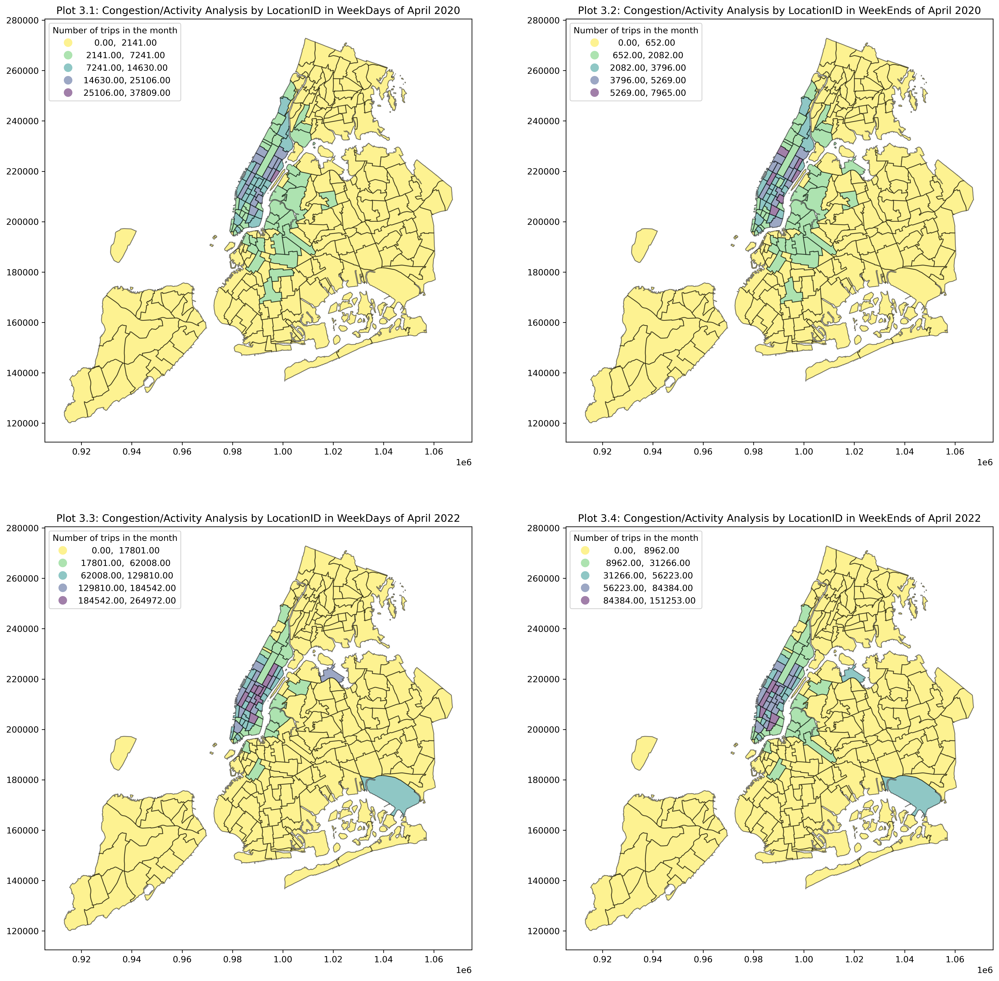

In [55]:
#Lines 10-13 : Geopandas.org
#URL: https://geopandas.org/en/stable/index.html
#Accessed on 4 Dec 19.00

# Subplots to display the NY city maps 
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20,20), dpi=300)

# Plotting the geopandas plots using the filtered data
# schemes = equal_interval , quantiles....remove schemes to get color bar
df_gpd_weekday_2020.plot( column='Number_of_trips', edgecolor='k', cmap='viridis_r', alpha=.5, ax=ax1, legend=True , legend_kwds={'loc': 'upper left', 'title': 'Number of trips in the month'} , scheme='natural_breaks')
df_gpd_weekend_2020.plot( column='Number_of_trips', edgecolor='k', cmap='viridis_r', alpha=.5, ax=ax2, legend=True , legend_kwds={'loc': 'upper left', 'title': 'Number of trips in the month'} , scheme='natural_breaks')
df_gpd_weekday_2022.plot( column='Number_of_trips', edgecolor='k', cmap='viridis_r', alpha=.5, ax=ax3, legend=True , legend_kwds={'loc': 'upper left', 'title': 'Number of trips in the month'} , scheme='natural_breaks')
df_gpd_weekend_2022.plot( column='Number_of_trips', edgecolor='k', cmap='viridis_r', alpha=.5, ax=ax4, legend=True , legend_kwds={'loc': 'upper left', 'title': 'Number of trips in the month'} , scheme='natural_breaks')

# Assigning title for the plots
ax1.set_title('Plot 3.1: Congestion/Activity Analysis by LocationID in WeekDays of April 2020')
ax2.set_title('Plot 3.2: Congestion/Activity Analysis by LocationID in WeekEnds of April 2020')
ax3.set_title('Plot 3.3: Congestion/Activity Analysis by LocationID in WeekDays of April 2022')
ax4.set_title('Plot 3.4: Congestion/Activity Analysis by LocationID in WeekEnds of April 2022')



### Plot 3 - Analysis

Dependency Libraries: geopandas, folium. The above plots illustrates the congestion/activity analysis in years 2020 and 2022. To further explain the analysis, the number of trips are also grouped by weekday and weekend trips. The following are the assumptions that have been made in this plot. 

<br>
a. "Congestion_surcharge" and "extra" are the variables used here to explain activity during and after the COVID pandemic. <br>
b. "Pickup time" has been used to group the total trips by weekdays and weekends <br>
c. "Pickup location" has been used to justify activity/congestion <br>

For all plots from 3.1 to 3.4, interactive maps have been given to identify the zones and locations easily.
The plot 3.1 and 3.2 clearly shows the number of trips during COVID [2020] are far less compared to 3.3 and 3.4 [2022 trips] JFK Airport (LocationID: 132] is one of the places which shows the pandemic impact clearly. In plot 3.1, the number of trips is 1172, while plot 3.2 shows better activity. But plots 3.3 and 3.4 show that the activity is way better compared to April 2020. The same logic applies for the Central Park location which also happens to be a tourism spot. Activity is less there in 2020, but in 2022 it is one of the busiest places in the NY city. Overall, Manhattan zones seem to be the one which has the most activity in all periods. But even there, there is a clear drop in activity from the year 2020 (number of trips) as can be seen in the legends.

In [56]:
import folium
# This is just for reference 
df_gpd_weekday_2020.explore('Number_of_trips', cmap='viridis_r', tiles = "CartoDB positron", tooltip = ['zone', 'PULocationID', 'borough', 'Number_of_trips'], legend = True, scheme = 'natural_breaks' )


In [57]:
df_gpd_weekend_2020.explore('Number_of_trips', cmap='viridis_r', tiles = "CartoDB positron", tooltip = ['zone', 'PULocationID', 'borough', 'Number_of_trips'], legend = True, scheme = 'natural_breaks' )

In [58]:
df_gpd_weekday_2022.explore('Number_of_trips', cmap='viridis_r', tiles = "CartoDB positron", tooltip = ['zone', 'PULocationID', 'borough', 'Number_of_trips'], legend = True, scheme = 'natural_breaks' )


In [65]:
df_gpd_weekend_2022.explore('Number_of_trips', cmap='viridis_r', tiles = "CartoDB positron", tooltip = ['zone', 'PULocationID', 'borough', 'Number_of_trips'], legend = True, scheme = 'natural_breaks' )


## Plot 4 : How tips changes over years and what will be the main factors

In [66]:
# Subtopic 4
# The purpose of this subproblem is to know the relationships between variables of 
# year of pandemic, tips, and fare. 

In [67]:
def tips_amount_year_heatmap(year):
    '''
        Reads the 'year' variable called by the user and returns the contents as mentioned below

        Parameters
        ----------
        year    :   '2019', '2020', '2021','2022'

        Returns
        -------
        df_tips_final : df of tips based on year 
        
    
        Additional Info
        -------
        None
    '''
    
    month = '06'
    df_tips_final = pd.DataFrame({})
    filelist = []
    dfnamelist = []
    cabtype = ['yellow','green']
    
    # Retrieving the data
    for i in cabtype:
        filename = i + '_tripdata_' + year + '-' + month + '.parquet'
        filelist.append(filename)
    
    for i in cabtype:
        dfname = 'df_' + year + '_' + month
        dfnamelist.append(dfname)

    # Defining the empty lists for the final values

    for i in range(len(dfnamelist)):
        dfnamelist[i] = pd.read_parquet(filelist[i])
        
        #To clean the NA rows
        dfnamelist[i].dropna(how = 'any')
    
    # Building the df
    
    for i in range(len(cabtype)):
   
        if cabtype[i] == 'yellow':
            
            df_tips = pd.DataFrame({'Taxi_Type': int(1), 'Tips': dfnamelist[i]['tip_amount'], 
                               'Fare': dfnamelist[i]['fare_amount'],
                                   'Trip_distance': dfnamelist[i]['trip_distance'] ,
                                   'Passenger_count': dfnamelist[i]['passenger_count'] }) 
        elif cabtype[i] == 'green':
            df_tips = pd.DataFrame({'Taxi_Type': int(2), 'Tips': dfnamelist[i]['tip_amount'], 
                               'Fare': dfnamelist[i]['fare_amount'],
                                   'Trip_distance': dfnamelist[i]['trip_distance'] ,
                                   'Passenger_count': dfnamelist[i]['passenger_count']}) 
          
        else:
            
            df_tips = pd.DataFrame({'Taxi_Type': int(3), 'Tips': dfnamelist[i]['tips'],
                                   'Fare': dfnamelist[i]['base_passenger_fare']})
        
        df_tips_final = pd.concat([df_tips_final, df_tips], ignore_index = True)
        

    return df_tips_final


In [71]:
def heatmap_corr_year():
    '''
        Returns the contents as mentioned below

        
        Returns
        -------
        3 subplots of heatmap of correlation among year, fare, and tips
        based on cabtype in June 2019, 2020, 2021, 2022
        
    
        Additional Info
        -------
        None
    '''
    df_2019_tips = tips_amount_year_heatmap('2019')
    df_2020_tips = tips_amount_year_heatmap('2020')
    df_2021_tips = tips_amount_year_heatmap('2021')
    df_2022_tips = tips_amount_year_heatmap('2022')

    corr_2019 = df_2019_tips.corr()
    corr_2020 = df_2020_tips.corr()
    corr_2021 = df_2021_tips.corr()
    corr_2022 = df_2022_tips.corr()
    
    
    # Define plotting region (2 rows, 2 columns)
    fig = plt.figure(figsize = (12, 12), dpi = 250)
    fig.suptitle('Heatmap of the Impact of Pandemic Years to Taxi Variables, June YoY, Green & Yellow Only', fontsize = 20)
    fig.subplots_adjust(wspace = 0.2, hspace = 0.2, top = 0.9, right = 1)
    
    # Plot 2019
    plt.subplot(2,2,1)
    sns.heatmap(corr_2019, cmap= 'RdBu', square = True).set(title = '2019')
    
    # Plot 2020
    plt.subplot(2,2,2)
    sns.heatmap(corr_2020, cmap='RdBu', square = True).set(title = '2020')
    
    # Plot 2021
    plt.subplot(2,2,3)
    sns.heatmap(corr_2021, cmap='RdBu', square = True).set(title = '2021')
    
    # Plot 2022
    plt.subplot(2,2,4)
    sns.heatmap(corr_2022, cmap='RdBu', square = True).set(title = '2022')
    
    plt.show()
    


In [72]:
def tips_amount_year(year):
    '''
        Reads the 'year' variable called by the user and returns the contents as mentioned below

        Parameters
        ----------
        year    :   '2019', '2020', '2021','2022'

        Returns
        -------
        df_tips_final : df of tips based on year 
        
    
        Additional Info
        -------
        None
    '''
    
    month = '06'
      
    
    # Retrieving the data
    filename_green = 'green' + '_tripdata_' + year + '-' + month + '.parquet'
    filename_yellow = 'yellow' + '_tripdata_' + year + '-' + month + '.parquet'
    
    df_green = pd.read_parquet(filename_green)
    df_yellow = pd.read_parquet(filename_yellow)
    df_green.dropna(how = 'any')
    df_yellow.dropna(how = 'any')
    green_tips_total = sum(df_green['tip_amount'])
    yellow_tips_total = sum(df_yellow['tip_amount'])
        
        
    return yellow_tips_total, green_tips_total



In [73]:
def line_tips():
    '''
        Returns the contents as mentioned below

        
        Returns
        -------
        1 line plot for tips of Green & Yellow in June 2019, 2020, 2021, 2022
        
    
        Additional Info
        -------
        None
    '''
    df_2019_tips = tips_amount_year('2019')
    df_2020_tips = tips_amount_year('2020')
    df_2021_tips = tips_amount_year('2021')
    df_2022_tips = tips_amount_year('2022')
    
    year_list = ['2019','2020','2021','2022']
    # Yellow
    tips_2019_yellow = tips_amount_year('2019')[0]
    tips_2020_yellow = tips_amount_year('2020')[0]
    tips_2021_yellow = tips_amount_year('2021')[0]
    tips_2022_yellow = tips_amount_year('2022')[0]
    
    # Green
    tips_2019_green = tips_amount_year('2019')[1]
    tips_2020_green = tips_amount_year('2020')[1]
    tips_2021_green = tips_amount_year('2021')[1]
    tips_2022_green = tips_amount_year('2022')[1]
    
    tips_yellow = [tips_2019_yellow, tips_2020_yellow, tips_2021_yellow, tips_2022_yellow]
    tips_green = [tips_2019_green, tips_2020_green, tips_2021_green, tips_2022_green]
 
    # plot lines
    plt.figure(figsize = (12, 6), dpi = 250)
    plt.title('Yellow and Green Cab Tips YoY', fontsize = 12)
       
    plt.plot(year_list, tips_yellow, color = 'k', label = 'Yellow Cab Tips')
    plt.plot(year_list, tips_green, color = 'g', label = 'Green Cab Tips')
    
    plt.legend()
    plt.show()


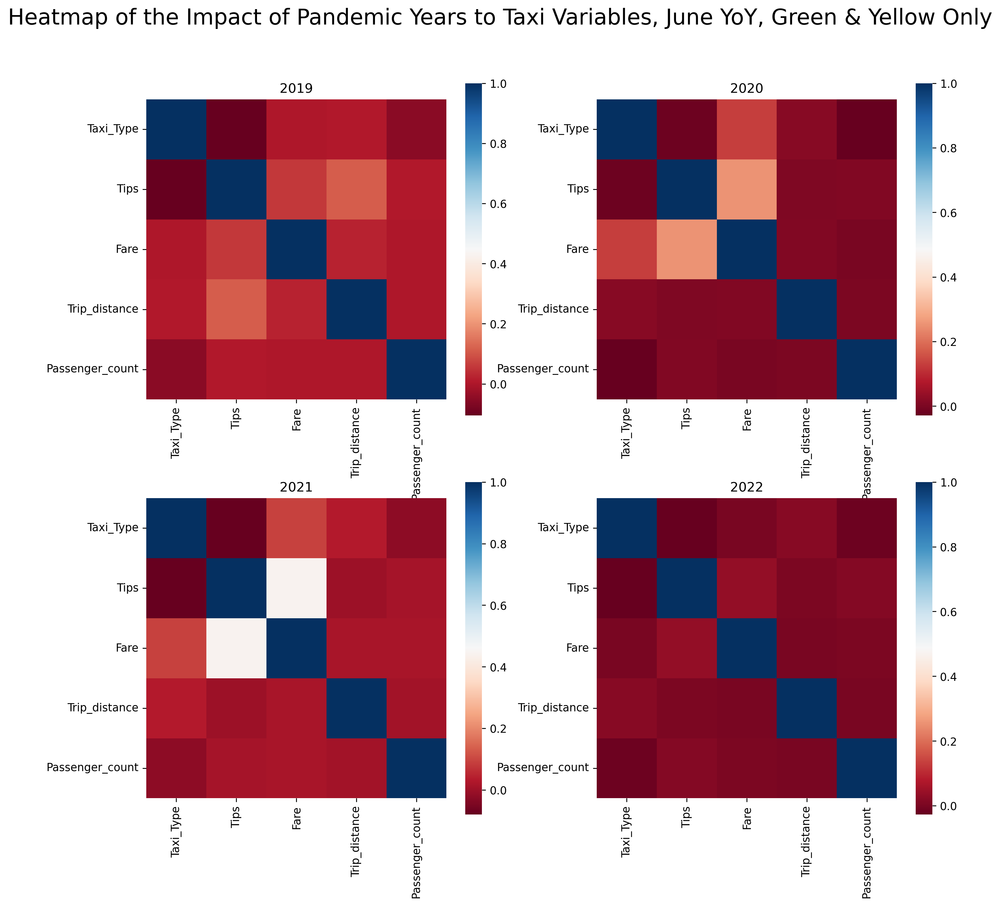

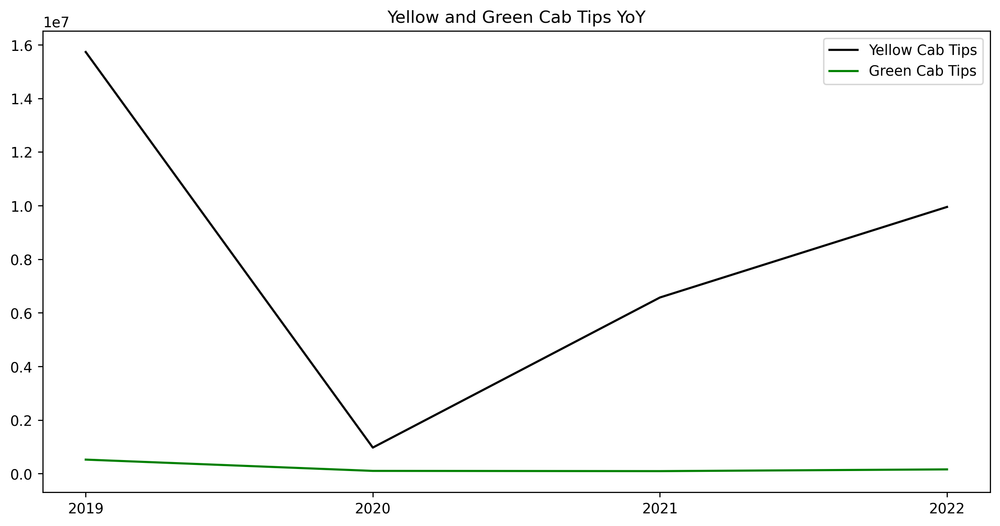

In [74]:
heatmap_corr_year()  
line_tips() 

### Plot 4 - Analysis

Plot three uses the same data picked in plot two and tries to narrow down how the economy has been affected by COVID by reflecting on tips amount. It contains a line chart representing the changes in total tip amount over the years and correlation heatmaps which can explain the correlation between tips and possible factors, which are passenger count, taxi type, fare amount, and trip distance each year. 

The line graph illustrates the tip amount for two types of taxis, which are yellow and green tax, changes from 2019 to 2022. The tips given to yellow taxi drivers experienced a sharp fall in 2020, the pandemic year, which then increased rapidly after the pandemic year. On the other hand, green taxi drivers receive almost no tips compared with yellow taxi drivers.

The correlation heatmap shows that the higher the correlation, the bluer the color is, and vice versa. Overall, from these four years of correlation heatmaps, fare amount has the highest correlation to tips, which means it is the most important factor that tips depend on. The average correlation over these 4 years between fare amount and tips are approximately 0.3 to 0.4. Conversely, the least possible factor is passenger-count, which reaches almost 0 in correlation. This is because increasing or decreasing the passenger does not impact the given tips much. The other two factors, the taxi type and the trip distance, have an average correlation constant of approximately equal to 0.1 and thus have less impact on tips.

Consequently, the tips given to drivers mainly depend on the fare amount, especially in the year 2021, which reaches 0.5 in correlation. Combining data in the line graph and plot two finds out that the tips started to increase rapidly this year, as well as the total fare amount. However, the correlation between fare amount and tips reaches the lowest, nearly 0.1, in 2022. 

# Conclusion

Based on the 4 main plots above, we can conclude that the COVID-19 has affected NYC business activities. 
<br>
From **Subtopic 1**, we learn that the passenger count and trip distance were affected during the pandemic years because of fear for being infected and the mobility restriction. <br>
From **Subtopic 2** we learn that tourism industry, represented by the airport trips (from/to) and tourism spot trips (from/to) saw an impact because of the government closing non-essential businesses and restrict mobility. Moreover, due to the decreasing trips, the total income (by using fare amount only) saw the decrease during the early pandemic in 2020, but slowly recovering until 2022.
<br>
From **Subtopic 3**, the congested locations on the map shows that the pandemic has decreased the level of human activities. Therefore, we see the contrast in the congested locations (airport and Manhattan) between 2020 and 2022 data. In 2022, we can see more trips in the busy areas than in 2020.
<br>
And lastly, from **Subtopic 4**, there is a medium to strong correlation between fare and tips. 
Therefore, the impact is we can see that the onset of pandemic in 2020 did hit the tips amount received by the cab drivers. However, it slowly returns in 2022 because of more trips taken and higher fares are paid. This validates our assumption that when the mobility restrictions are relaxed, the economy and purchasing power represented by tipping can return to its normal level. 
In summary, from our analyses, it is shown that COVID-19 delivered massive impact to the transportation business.